# !!!!! Dont execute this code if the image is already downloaded!
## This code downloads the images of the depth chart at max resulution and combines them to 1 large image.

In [10]:
import math
import requests
from PIL import Image
from io import BytesIO
from concurrent.futures import ThreadPoolExecutor, as_completed
import time
import sys

# WMTS URL (replace with the actual one you are using)
WMTS_URL = "https://cache.kartverket.no/v1/wmts?layer=sjokartraster&style=default&tilematrixset=webmercator&Service=WMTS&Request=GetTile&Version=1.0.0&Format=image/png&TileMatrix={z}&TileCol={x}&TileRow={y}"

# Convert latitude and longitude to tile X, Y
def latlon_to_tile(lat, lon, zoom):
    n = 2.0 ** zoom
    xtile = int((lon + 180.0) / 360.0 * n)
    ytile = int((1.0 - math.log(math.tan(math.radians(lat)) + (1 / math.cos(math.radians(lat)))) / math.pi) / 2.0 * n)
    return xtile, ytile

def fetch_with_retry(url, retries=3, timeout=2, delay=1):
    """
    Fetch a URL with retry logic.

    Args:
        url (str): The URL to fetch.
        retries (int): Number of retry attempts.
        timeout (int): Timeout for each request in seconds.
        delay (int): Delay between retries in seconds.

    Returns:
        bytes: The content of the response if successful, None otherwise.
    """
    for attempt in range(1, retries + 1):
        try:
            response = requests.get(url, timeout=timeout)
            response.raise_for_status()  # Raise HTTPError for bad responses (4xx and 5xx)
            return response.content
        except requests.exceptions.RequestException:
            if attempt < retries:
                time.sleep(delay)
    return None

def download_tile(x, y, z):
    url = WMTS_URL.format(z=z, x=x, y=y)
    content = fetch_with_retry(url)
    if content:
        return Image.open(BytesIO(content))
    return None

def fetch_tiles(lat1, lon1, lat2, lon2, zoom):
    # Convert lat/lon to tile coordinates
    x_min, y_min = latlon_to_tile(lat1, lon1, zoom)
    x_max, y_max = latlon_to_tile(lat2, lon2, zoom)

    # Ensure x_min < x_max and y_min < y_max
    x_min, x_max = min(x_min, x_max), max(x_min, x_max)
    y_min, y_max = min(y_min, y_max), max(y_min, y_max)

    # Tile size (WMTS tiles are usually 256x256 pixels)
    tile_size = 256

    # Create an empty image to hold the combined tiles
    width = (x_max - x_min + 1) * tile_size
    height = (y_max - y_min + 1) * tile_size
    combined_image = Image.new("RGBA", (width, height))

    # Prepare a list of tile coordinates
    tile_coords = [(x, y, zoom) for x in range(x_min, x_max + 1) for y in range(y_min, y_max + 1)]
    total_tiles = len(tile_coords)
    done_tiles = 0
    failed_tiles = 0

    # Fetch tiles concurrently
    with ThreadPoolExecutor() as executor:
        future_to_tile = {executor.submit(download_tile, x, y, z): (x, y) for x, y, z in tile_coords}
        for future in as_completed(future_to_tile):
            x, y = future_to_tile[future]
            try:
                tile = future.result()
                if tile:
                    # Calculate the position to paste the tile
                    x_offset = (x - x_min) * tile_size
                    y_offset = (y - y_min) * tile_size
                    combined_image.paste(tile, (x_offset, y_offset))
                    done_tiles += 1
                else:
                    failed_tiles += 1
            except Exception:
                failed_tiles += 1

            # Print progress
            progress = f"{done_tiles}/{failed_tiles}/{total_tiles} tiles processed."
            sys.stdout.write(f"\r{progress}")
            sys.stdout.flush()

    return combined_image

# Example usage
if __name__ == "__main__":
    # Define the bounding box (lat/lon)
    lat1, lon1 = 63.523173, 7.677666  # Top-left corner
    lat2, lon2 = 63.352638, 8.477415  # Bottom-right corner
    zoom = 14

    # Fetch tiles and combine into one image
    combined_image = fetch_tiles(lat1, lon1, lat2, lon2, zoom)

    # Save the resulting image
    combined_image.save("combined_map.png")
    print("Combined map saved as combined_map.png")


665/1/666 tiles processed.Combined map saved as combined_map.png


# This code converts the image

In [22]:
import cv2
import numpy as np

# Load the image
image_path = "combined_map.png"
image = cv2.imread(image_path)

# Convert the image to RGB (OpenCV loads in BGR by default)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Function to check if a pixel is black or gray
def is_black_or_gray(pixel):
    r, g, b = pixel
    # Check if the pixel is close to gray (R = G = B) and not too far from black
    return abs(r - g) < 20 and abs(g - b) < 20 and (r < 200 and g < 200 and b < 200)

# Loop through each pixel and turn non-black/gray pixels to white
for i in range(image_rgb.shape[0]):
    for j in range(image_rgb.shape[1]):
        pixel = image_rgb[i, j]
        if not is_black_or_gray(pixel):
            image_rgb[i, j] = [255, 255, 255]  # Turn non-black/gray pixels to white

# Convert back to BGR for saving/displaying
image_bgr = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2BGR)

# Save the modified image
cv2.imwrite("modified_map_black_gray.png", image_bgr)


/var/folders/lv/hl2jq4751bg6m9mwrq99qwdh0000gn/T/ipykernel_23868/4182137364.py:15: RuntimeWarning: overflow encountered in ubyte_scalars
  return abs(r - g) < 20 and abs(g - b) < 20 and (r < 200 and g < 200 and b < 200)


True

# This code tries to extract the depth readings from the image and writes them back to a diffrent image for visualization

In [1]:
import cv2
import pytesseract
import numpy as np

# Load the modified image (the one where non-black/gray pixels are turned to white)
image_path = "modified_map_black_gray.png"
image = cv2.imread(image_path)

# Convert the image to grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply Gaussian blur to reduce noise
blurred = cv2.GaussianBlur(gray, (5, 5), 0)

# Apply adaptive thresholding to improve text extraction under uneven lighting
adaptive_thresh = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                       cv2.THRESH_BINARY_INV, 11, 2)

# Perform morphological operations to clean up the text regions
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2, 2))
cleaned = cv2.morphologyEx(adaptive_thresh, cv2.MORPH_CLOSE, kernel)

# OCR to extract text and bounding boxes for each word (target only integers)
custom_config = r'--oem 3 --psm 6 -c tessedit_char_whitelist=0123456789'
data = pytesseract.image_to_data(cleaned, config=custom_config, output_type=pytesseract.Output.DICT)

# Annotate the image with red dots and the identified numbers
for i in range(len(data['text'])):
    text = data['text'][i]
    if text.strip().isdigit():  # Only consider text that is a valid integer
        # Get the bounding box coordinates for the word
        x, y, w, h = data['left'][i], data['top'][i], data['width'][i], data['height'][i]
        
        # Draw a red dot at the center of each detected number
        center_x, center_y = x + w // 2, y + h // 2
        cv2.circle(image, (center_x, center_y), 5, (0, 0, 255), -1)  # Red dot
        
        # Annotate the number near the dot
        cv2.putText(image, text, (center_x + 10, center_y + 10), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

# Save the annotated image
cv2.imwrite("annotated_depth_map_with_integers_improved.png", image)


True

# The following code is getting the cooridnates extracted and tries to generate a 3d space by interpolation

In [13]:
import cv2
import pytesseract
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.interpolate import griddata

# Load the modified image
image_path = "modified_map_black_gray.png"
image = cv2.imread(image_path)

# Convert the image to grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply Gaussian blur to reduce noise
blurred = cv2.GaussianBlur(gray, (5, 5), 0)

# Apply adaptive thresholding to improve text extraction under uneven lighting
adaptive_thresh = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                       cv2.THRESH_BINARY_INV, 11, 2)

# Perform morphological operations to clean up the text regions
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2, 2))
cleaned = cv2.morphologyEx(adaptive_thresh, cv2.MORPH_CLOSE, kernel)

# OCR to extract text and bounding boxes for each word (target only integers)
custom_config = r'--oem 3 --psm 6 -c tessedit_char_whitelist=0123456789'
data = pytesseract.image_to_data(cleaned, config=custom_config, output_type=pytesseract.Output.DICT)

# Extract coordinates and depth values
coordinates = []
depth_values = []

for i in range(len(data['text'])):
    text = data['text'][i]
    if text.strip().isdigit():  # Only consider text that is a valid integer
        # Get the bounding box coordinates for the word
        x, y, w, h = data['left'][i], data['top'][i], data['width'][i], data['height'][i]
        
        # Calculate the center of the bounding box
        center_x, center_y = x + w // 2, y + h // 2
        depth = int(text.strip())
        # Only consider depth values above 300
        coordinates.append((center_x, center_y, depth))

# Convert coordinates to numpy array
coordinates = np.array(coordinates)



Min Z: 0, Max Z: 299


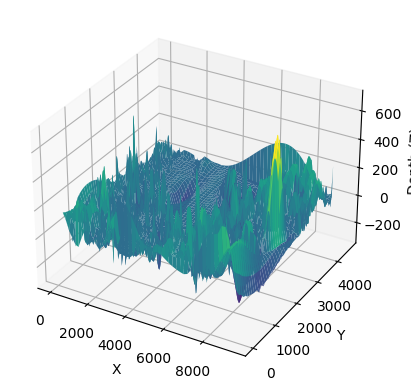

In [43]:
# Prepare data for interpolation
x_vals = coordinates[:, 0]
y_vals = coordinates[:, 1]
z_vals = coordinates[:, 2]

# Assuming `coordinates` is a NumPy array with shape (n, 3)
x_vals = coordinates[:, 0]
y_vals = coordinates[:, 1]
z_vals = coordinates[:, 2]


# Create a mask for valid depth values (0 <= z <= 300)
valid_mask = (z_vals >= 0) & (z_vals <= 300)
z_vals = -z_vals
# Filter the coordinates
filtered_coordinates = coordinates[valid_mask]

# Optionally, extract the filtered x, y, z values
filtered_x_vals = filtered_coordinates[:, 0]
filtered_y_vals = filtered_coordinates[:, 1]
filtered_z_vals = filtered_coordinates[:, 2]
print(f"Min Z: {np.min(filtered_z_vals)}, Max Z: {np.max(filtered_z_vals)}")
# Create a grid for interpolation
grid_x, grid_y = np.meshgrid(np.linspace(np.min(filtered_x_vals), np.max(filtered_x_vals), 500),
                             np.linspace(np.min(filtered_y_vals), np.max(filtered_y_vals), 500))

# Interpolate depth values over the grid
grid_z = griddata((filtered_x_vals, filtered_y_vals), filtered_z_vals, (grid_x, grid_y), method='cubic')

# Create 3D plot of the interpolated surface
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Plot the surface
ax.plot_surface(grid_x, grid_y, grid_z, cmap='viridis')

# Set labels for axes

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Depth (Z)')

# Show the plot
plt.show()


In [48]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize

# Load the original image
image_path = "modified_map_black_gray.png"
original_image = cv2.imread(image_path)

# Create an empty image (or you can use the original image)
heatmap_image = np.zeros_like(original_image, dtype=np.uint8)

# Normalize the z values for visualization
norm = Normalize(vmin=np.min(filtered_z_vals), vmax=np.max(filtered_z_vals))

# Map z values to a color range (you can adjust the colormap)
colormap = plt.get_cmap('jet')

for x, y, z in zip(filtered_x_vals, filtered_y_vals, filtered_z_vals):
    # Normalize the depth value to a color (RGBA)
    rgba_color = colormap(norm(z))

    # Extract the RGB values and scale them to 0-255
    rgb_color = np.array(rgba_color[:3] * 255, dtype=np.uint8)

    # Ensure the color is a 3-channel (RGB) color array
    if len(rgb_color) == 3:
        # Overlay the heatmap at the corresponding (x, y) coordinate
        if 0 <= x < original_image.shape[1] and 0 <= y < original_image.shape[0]:
            heatmap_image[y, x] = rgb_color  # Apply RGB color

# Blend the heatmap with the original image
alpha = 0.6  # Transparency factor
blended_image = cv2.addWeighted(original_image, 1 - alpha, heatmap_image, alpha, 0)

# Save or display the final image
cv2.imwrite("heatmap_overlay.png", blended_image)





True

In [31]:
import plotly.graph_objects as go
from scipy.interpolate import griddata
# Create a grid for interpolation
grid_x, grid_y = np.meshgrid(np.linspace(np.min(filtered_x_vals), np.max(filtered_x_vals), 500),
                             np.linspace(np.min(filtered_y_vals), np.max(filtered_y_vals), 500))

# Interpolate depth values over the grid
grid_z = griddata((filtered_x_vals, filtered_y_vals), filtered_z_vals, (grid_x, grid_y), method='cubic')

# Create an interactive 3D plot using plotly
fig = go.Figure(data=[go.Surface(z=grid_z, x=grid_x, y=grid_y, colorscale='Viridis')])

# Set the labels for axes
fig.update_layout(
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='Depth (Z)'
    ),
    title='Interactive Depth Map'
)

# Show the plot
fig.show()

nan
nan
